# Automated Air-Liquid Interface Cell Culture Analysis Using Deep Optical Flow

## Autogenerated Report: RAINBOW Air-Liquid Interface Cell Culture Analysis
#### Website: https://github.com/AlphonsG/Rainbow-Optical-Flow-For-ALI

In [30]:
# %matplotlib widget

import json
import os
from collections import defaultdict

import cv2

from IPython.display import Image, Video

import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow 

import pandas as pd

import rainbow
from rainbow.data_analysis import (gen_base_metrics, dirn_scatter,
                                   mag_scatter, save_stats,
                                   save_quiver_plots, save_heatmaps,
                                   save_polar_plots)
from rainbow.optical_flow.optical_flow import flow_to_img
from rainbow.util import (cleanup_dir, comb_imgs, load_optical_flow, load_std_imgs, 
                          save_video, save_img_ser, video_reshape) 

import yaml

VID_FILENAME = 'Video'

## Source directory

In [31]:
curr_dir = os.getcwd()
print(curr_dir)

/mnt/hdd2/Alphons/Rainbow-Optical-Flow-For-ALI/examples/example_image_series/tif_191018_HNA-ALI_d14.nd2_-_191018_HNA-ALI_d14.nd2_(series_03)0000_etc


## Image Series Type

In [32]:
# Load metadata
with open(f'{rainbow.METADATA_FILENAME}.json') as f:
    metadata = json.load(f)
    
print(metadata['type'])

.tif


## RAINBOW Analysis Timestamp

In [33]:
print(metadata['analysis_timestamp'])

10 March 2022, 15:57:34


## Image Series Metadata

In [34]:
print(json.dumps(metadata, sort_keys=True, indent=4))

{
    "analysis_timestamp": "10 March 2022, 15:57:34",
    "calibration_um": 0.31302569743655434,
    "dir": "examples/example_image_series",
    "type": ".tif"
}


In [35]:
data = defaultdict(list)
flow_path = rainbow.OPTICAL_FLOW_FILENAME
data['preds'] = load_optical_flow(flow_path)
data['raw_imgs'] = load_std_imgs(rainbow.RAW_IMGS_DIR_NAME, 
                                 metadata['calibration_um'])
gen_base_metrics(data)
for key, unit, filename in zip(['mag_stats', 'dirn_stats'], ['um', 'deg'], 
        [rainbow.MAG_STATS_FILENME, rainbow.DIRN_STATS_FILENME]):
    save_stats(data[key], os.path.join(f'{filename}.csv'), unit)

## Magnitude Statistics

In [36]:
df1 = pd.read_csv(f'{rainbow.MAG_STATS_FILENME}.csv', sep=',')
df1

,frame,min (um),max (um),mean (um),std (um),var (um)
0,0,0.001920,4.178234,2.138720,0.771738,0.595579
1,1,0.001551,3.935667,2.059078,0.799700,0.639520
2,2,0.102878,4.091494,2.039340,0.814543,0.663481
3,3,0.003530,3.479425,1.967105,0.759979,0.577568
4,4,0.004051,3.422691,1.889933,0.741848,0.550339
5,5,0.001329,3.128323,1.746436,0.634321,0.402363
6,6,0.005250,3.086464,1.701845,0.645827,0.417092
7,7,0.004330,3.372861,1.699563,0.644477,0.415350
8,8,0.002669,3.382966,1.754328,0.715596,0.512077
9,9,0.002633,3.494043,1.703855,0.734561,0.539580


## Direction Statistics

In [37]:
df2 = pd.read_csv(f'{rainbow.DIRN_STATS_FILENME}.csv', sep=',')
df2

,frame,min (deg),max (deg),mean (deg),std (deg),var (deg)
0,0,0.000098,360.000000,43.281408,42.713049,31.841866
1,1,0.000432,359.999237,35.513476,50.172646,43.935075
2,2,0.000003,359.999969,43.784291,50.391493,44.319190
3,3,0.000375,359.999969,36.392191,55.718097,54.183858
4,4,0.000753,359.999908,30.522460,63.856827,71.169193
5,5,0.000533,359.999969,34.993708,81.487163,115.892616
6,6,0.000154,359.999969,42.838753,88.519526,136.758879
7,7,0.000137,359.999969,29.267093,88.033618,135.261583
8,8,0.000022,359.999969,25.796501,83.577503,121.914723
9,9,0.000117,359.999725,18.781743,96.761745,163.412303


In [38]:
pd.merge(df1, df2).to_csv(f'{rainbow.MAG_STATS_FILENME}_and_{rainbow.DIRN_STATS_FILENME}.csv')

## Magnitude Scatter Plot

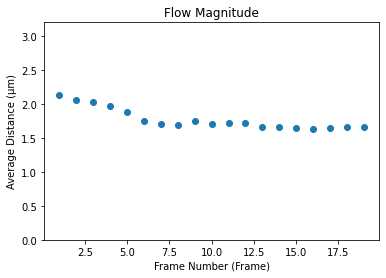

In [39]:
dpi = 1000
mag_scatter([s['mean'] for s in data['mag_stats']])
plt.savefig(f'{rainbow.MAG_SCATTER_FILENAME}.png', dpi=dpi)

## Direction Scatter Plot

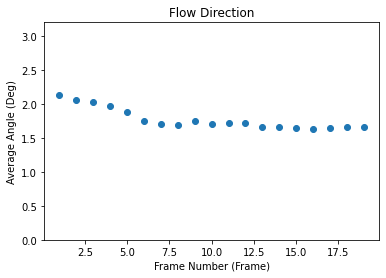

In [40]:
dirn_scatter([s['mean'] for s in data['mag_stats']])
plt.savefig(f'{rainbow.DIRN_SCATTER_FILENAME}.png', dpi=dpi)

In [41]:
data['flow_imgs'] = [flow_to_img(pred) for pred in data['preds']]
data['comb_imgs'] = [comb_imgs(img1, img2) for img1, img2 in zip(
                     data['raw_imgs'], data['flow_imgs'])]

for dir_name, imgs in zip([rainbow.FLOW_IMGS_DIR_NAME, rainbow.COMB_IMGS_DIR_NAME], 
                          [data['flow_imgs'], data['comb_imgs']]):
    img_ser_dir = os.path.join(curr_dir, dir_name)
    cleanup_dir(img_ser_dir)
    os.mkdir(img_ser_dir)  # already exists?
    save_img_ser(imgs, img_ser_dir, False)
    save_video(img_ser_dir, os.path.join(img_ser_dir, VID_FILENAME))

## Raw Image Series (left) and RAINBOW Optical Flow Visualisation (Right)

In [42]:
vid_path = os.path.join(rainbow.COMB_IMGS_DIR_NAME, VID_FILENAME + rainbow.util.VID_FILE_EXT)  
dsp_wdh, dsp_hgt = video_reshape(vid_path, 1000)
Video(vid_path, embed=True, width=dsp_wdh, height=dsp_hgt, html_attributes='controls loop')

a) The direction of motion at any position within RAINBOW generated optical flow images is measured clockwise from the initial horizontal position of a unit circle (left) and is shown using hue values (right). 

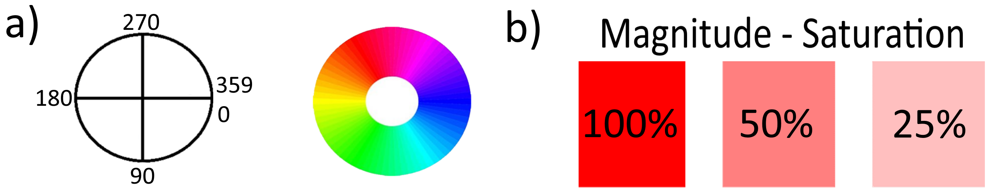

In [43]:
cleanup_dir(rainbow.HEATMAPS_DIR_NAME)
cleanup_dir(rainbow.QUIVER_PLOTS_DIR_NAME)
cleanup_dir(rainbow.POLAR_PLOTS_DIR_NAME)
os.mkdir(rainbow.HEATMAPS_DIR_NAME)
os.mkdir(rainbow.QUIVER_PLOTS_DIR_NAME)
os.mkdir(rainbow.POLAR_PLOTS_DIR_NAME)
plt.ioff()
save_heatmaps(data['preds'], rainbow.HEATMAPS_DIR_NAME)
save_quiver_plots(data['preds'], rainbow.QUIVER_PLOTS_DIR_NAME)
plt.close()

## Magnitude Heatmaps Across Image Series

Visualization of motion magnitiude using heatmap with hot colour mapping.

In [44]:
vid_path = os.path.join(rainbow.HEATMAPS_DIR_NAME, VID_FILENAME)  
save_video(rainbow.HEATMAPS_DIR_NAME, vid_path, 5)
vid_path += rainbow.util.VID_FILE_EXT
dsp_wdh, dsp_hgt = video_reshape(vid_path, 640)
Video(vid_path, embed=True, width=dsp_wdh, height=dsp_hgt, html_attributes='controls loop')

## Quiver Plots Across Image Series

Visualisation of optical flow using quiver plots containing vector arrows.

In [45]:
vid_path = os.path.join(rainbow.QUIVER_PLOTS_DIR_NAME, VID_FILENAME)  
save_video(rainbow.QUIVER_PLOTS_DIR_NAME, vid_path, 5) 
vid_path += rainbow.util.VID_FILE_EXT
dsp_wdh, dsp_hgt = video_reshape(vid_path, 640)
Video(vid_path, embed=True, width=dsp_wdh, height=dsp_hgt, html_attributes='controls loop')

## Polar Plots Across Image Series

Visualisation of optical flow using polar plots.

In [46]:
save_polar_plots(data['preds'], rainbow.POLAR_PLOTS_DIR_NAME, mpp=metadata['calibration_um'])
vid_path = os.path.join(rainbow.POLAR_PLOTS_DIR_NAME, VID_FILENAME)  
save_video(rainbow.POLAR_PLOTS_DIR_NAME, vid_path, 1)
vid_path += rainbow.util.VID_FILE_EXT
dsp_wdh, dsp_hgt = video_reshape(vid_path, 640)
Video(vid_path, embed=True, width=dsp_wdh, height=dsp_hgt, html_attributes='controls loop')